# Cell type annotation

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
from sklearn.metrics import confusion_matrix
from IPython.display import display
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
mic=["CD40","CD68","CEBPA","CEBPB","CX3CR1","ITGAM","PTPRC","TYROBP","APOE"]
ast=["GFAP","ALDH1L1","AQP4","SLC1A3","SLC1A2","GLUL"]
glu=["SLC17A7","GRIN1","GRIN2B"]
gab=["GAD1","GAD2","CCK"]
oli=["SOX10","MBP","MOG","OLIG1","OLIG2","PDGFRA","VCAN"]
end=['FLT1']
mks=mic+ast+glu+gab+oli+end

In [11]:
res=['0.1','0.15','0.2','0.25','0.3','0.35','0.4','0.45','0.5','0.55','0.6','0.65','0.7','0.75','0.8']

In [8]:
adata=sc.read("brain.h5ad")

In [4]:
sc.set_figure_params(dpi_save=300)

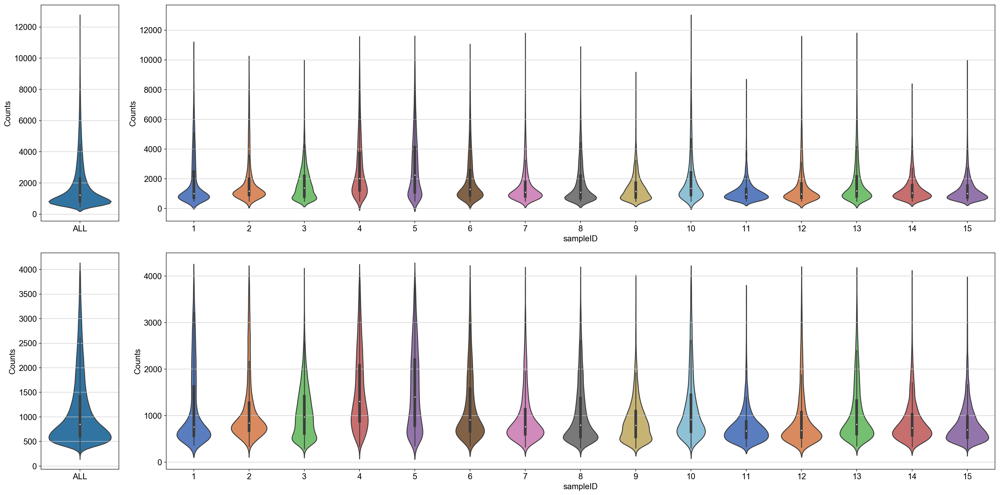

In [9]:
fig = plt.figure(figsize=(24,12))

ax1 = plt.subplot2grid((2, 8), (0, 0),colspan=1)
ax2 = plt.subplot2grid((2, 8), (0, 1), colspan=7)
ax3 = plt.subplot2grid((2, 8), (1, 0),colspan=1)
ax4 = plt.subplot2grid((2, 8), (1, 1), colspan=7)

ax1 = sns.violinplot(y='n_counts',data=adata.obs,ax=ax1)
ax1.set_xticklabels(labels=['ALL'])
ax1.set_ylabel("Counts")
ax2 = sns.violinplot('sampleID', y='n_counts', data=adata.obs,ax=ax2,palette=sns.color_palette("muted"))
ax2.set_ylabel("Counts")
ax3 = sns.violinplot(y='n_genes',data=adata.obs,ax=ax3)
ax3.set_xticklabels(labels=['ALL'])
ax3.set_ylabel("Counts")
ax4 = sns.violinplot('sampleID', y='n_genes', data=adata.obs,ax=ax4,palette=sns.color_palette("muted"))
ax4.set_ylabel("Counts")
plt.tight_layout()


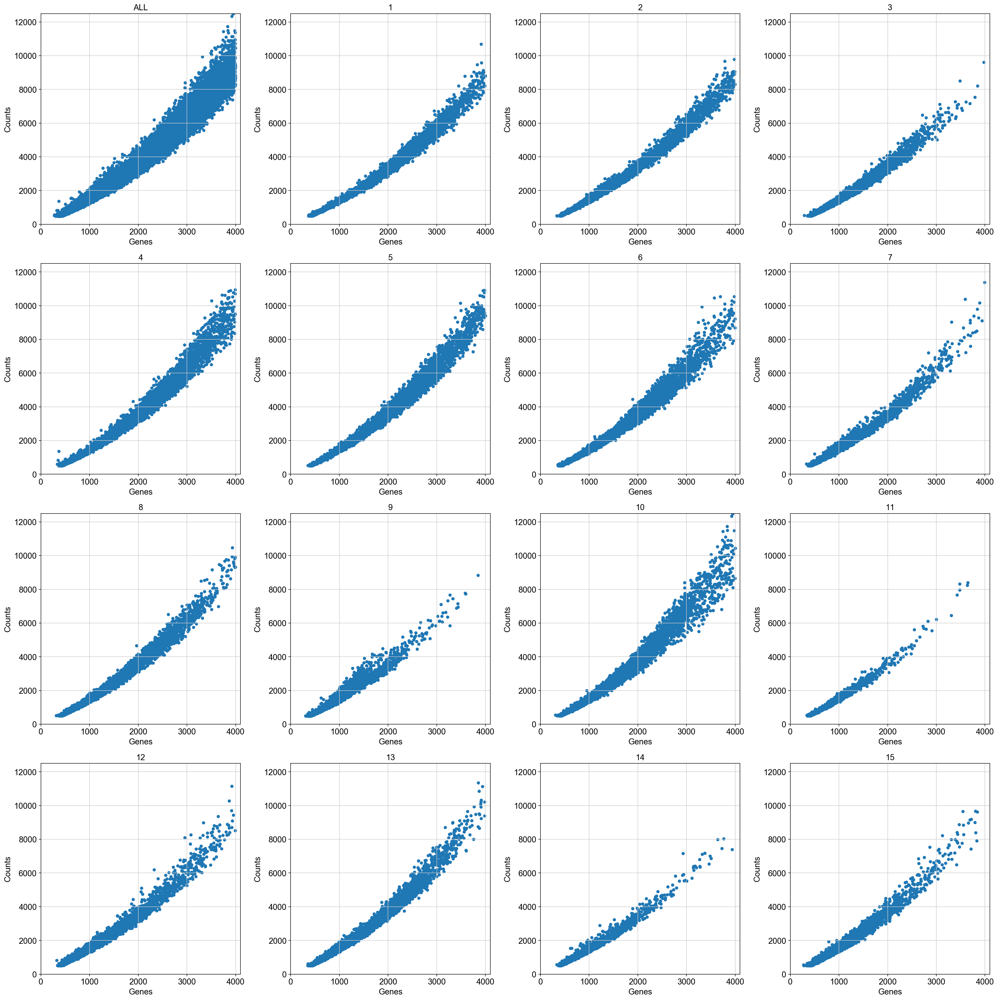

In [10]:
fig,axes=plt.subplots(nrows=4,ncols=4,figsize=(24,24))
axes[0][0]=adata.obs.plot.scatter(x='n_genes',y='n_counts',title='ALL',ax=axes[0][0])
axes[0][0].set_xlim(0,4100)
axes[0][0].set_ylim(0,12500)
axes[0][0].set_xlabel("Genes")
axes[0][0].set_ylabel("Counts")
i=0
j=1
str_cat=adata.obs['sampleID'].cat.categories
for i in range(0,4):
    for j in range(0,4):
        if i==0 and j==0:
            continue
        data=adata[adata.obs['sampleID']==str_cat[i*4+j-1]]
        axes[i][j]=data.obs.plot.scatter(x='n_genes',y='n_counts',title=str_cat[i*4+j-1],ax=axes[i][j])
        axes[i][j].set_xlim(0,4100)
        axes[i][j].set_ylim(0,12500)
        axes[i][j].set_xlabel("Genes")
        axes[i][j].set_ylabel("Counts")
plt.tight_layout()


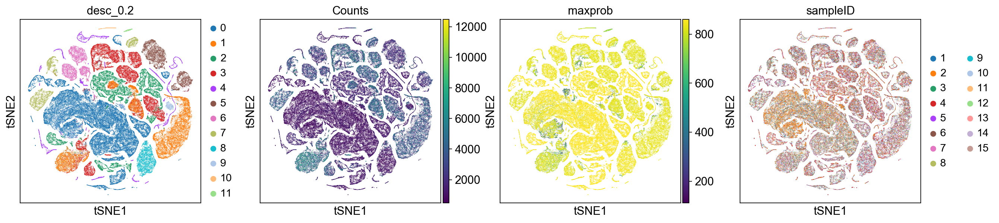

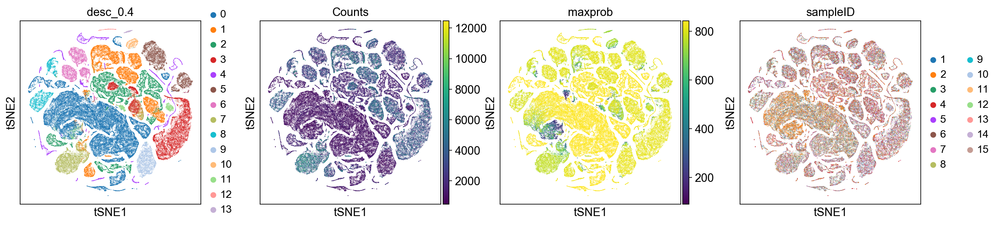

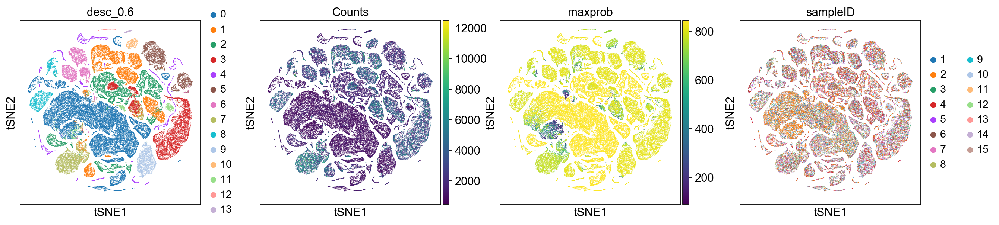

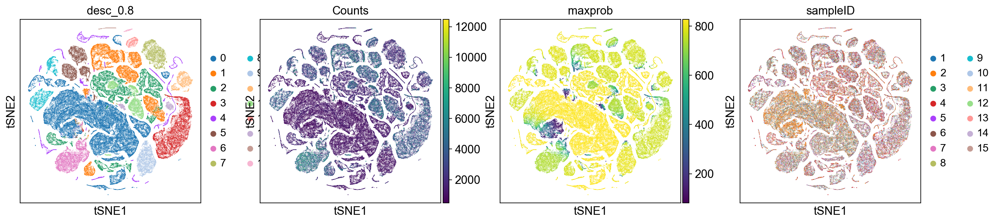

In [12]:
res=['0.2','0.4','0.6','0.8']
i=0
for ires in res:
    adata.obsm.X_tsne=adata.obsm['X_tsne'+ires]
    adata.obs['maxprob']=(np.max(adata.uns['prob_matrix'+ires],axis=1)*1000).astype(int)
    adata.obsm.X_tsne=adata.obsm['X_tsne'+ires]
    sc.pl.tsne(adata, color=['desc_'+ires,'n_counts','maxprob','sampleID'],title=['desc_'+ires,'Counts','maxprob','sampleID'])#,ax=axes[i])
    i=i+1


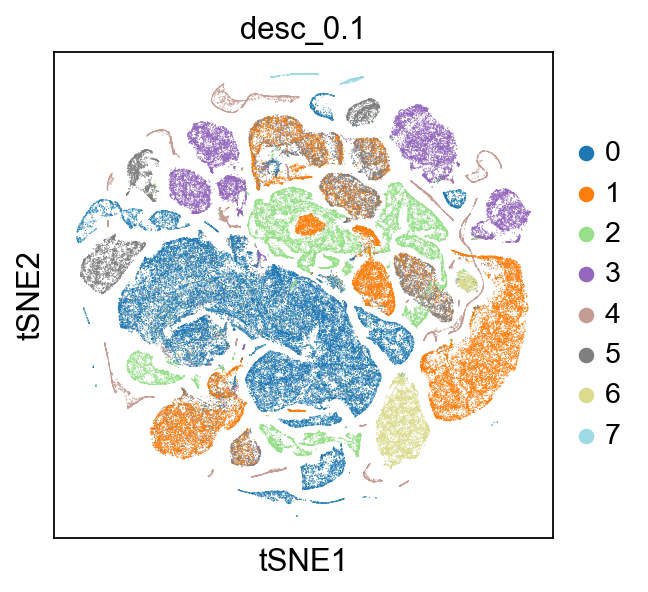

ast


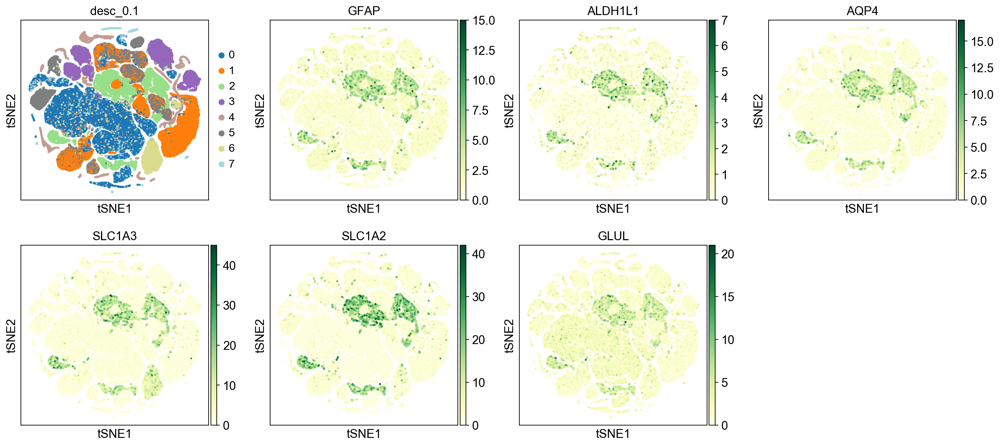

mic


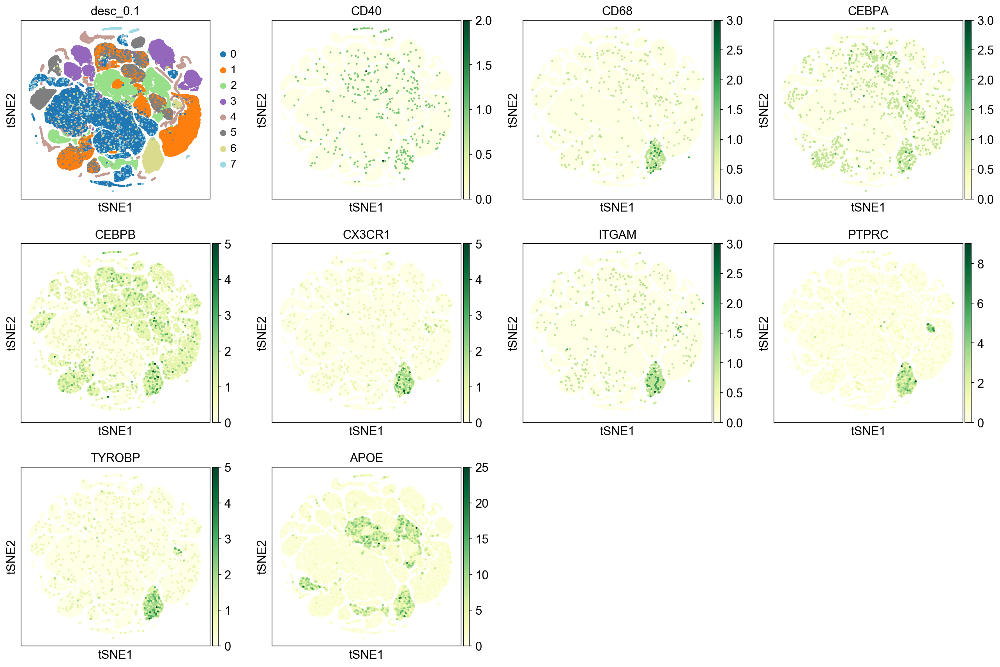

oli


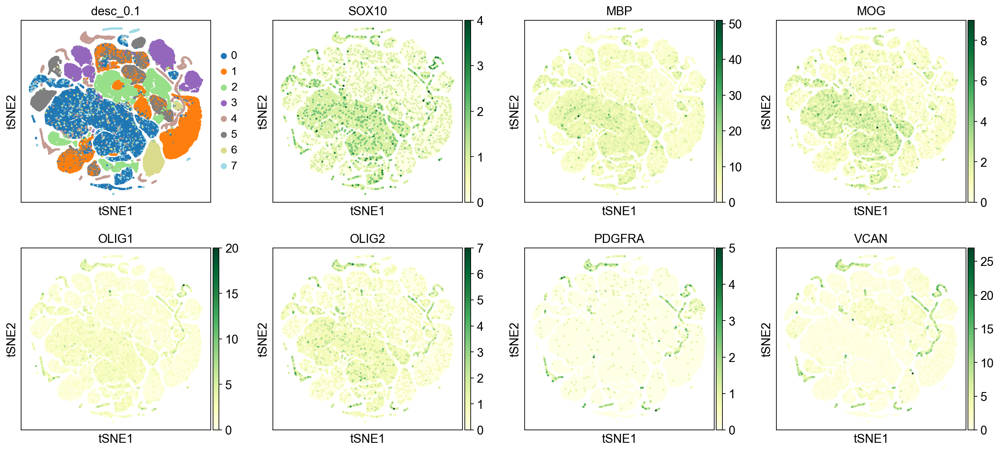

glu


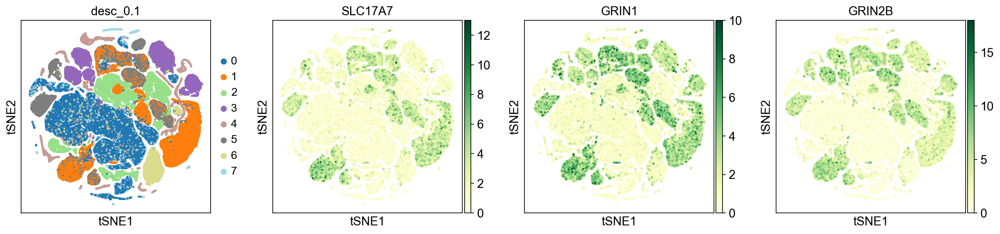

gab


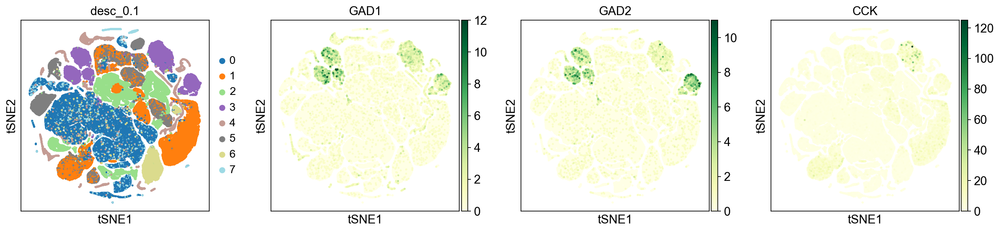

end


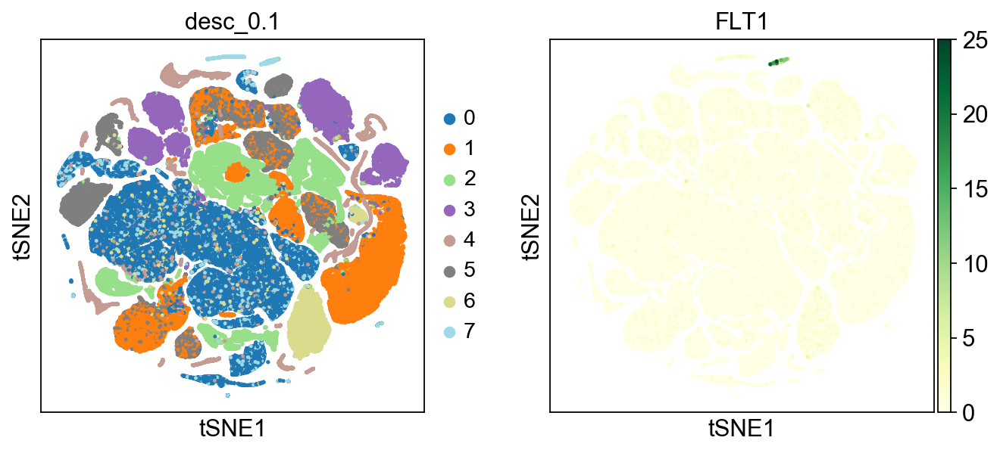

In [44]:
ires='0.1'
adata.obsm.X_tsne=adata.obsm['X_tsne'+ires]
sc.pl.tsne(adata, color=['desc_'+ires],palette='tab20')
for cell in ['ast','mic','oli','glu','gab','end']:
    print(cell)
    sc.pl.tsne(adata, color=['desc_'+ires]+vars()[cell],color_map="YlGn",size=20)

In [17]:
for i in range(0,len(res)-1):
    print("desc_"+res[i]+" vs desc_"+res[i+1])
    tab=confusion_matrix(adata.obs['desc_'+res[i]],adata.obs['desc_'+res[i+1]])
    tab=tab[np.sum(tab,axis=1)!=0,]
    display(pd.DataFrame(tab))

desc_0.2 vs desc_0.4


,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,44303,356,8,68,2,28,15,139,9,26,39,455,2,0
1,3,52,1,12751,1,3,1,4071,10,0,2,5,0,0
2,52,14,15823,45,4,9,3,47,4,3,3,7,0,0
3,20,15793,5,612,3,4,6,1921,5,0,4,2,0,1
4,38,13,0,9,6905,6,1,15,1,0,3,19,0,1
5,8,5,2,6,1,6417,10,48,1,1,1,2,0,0
6,12,9,0,7,2,11,6189,16,1,0,11,1,0,0
7,4,94,4,30,2,1,0,666,3632,1,1051,3,0,0
8,26,7,2,10,1,1,7,22,2,4081,1,3,0,0
9,1965,43,17,29,3,38,8,51,7,33,38,1720,4,1


desc_0.4 vs desc_0.6


,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,46390,7,0,0,0,0,1,0,0,2,0,35,1,0
1,3,16366,0,0,1,0,0,18,0,0,0,2,0,0
2,0,0,15859,0,0,0,0,0,0,0,0,3,0,0
3,0,1,0,13559,0,0,0,5,0,0,1,1,0,0
4,0,0,0,0,6925,0,0,0,0,0,0,0,0,0
5,0,0,1,0,0,6517,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,6239,0,0,0,0,1,0,0
7,0,11,1,10,0,0,1,6968,2,0,0,4,0,0
8,0,0,0,0,0,0,0,1,3671,0,0,0,0,0
9,0,0,0,2,0,0,0,0,0,4142,0,1,0,0


desc_0.6 vs desc_0.8


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,46070,114,11,51,3,16,37,13,1,9,6,13,3,46,1,1
1,32,15160,3,11,4,4,568,5,6,0,4,584,0,2,2,1
2,8,1,15767,8,3,8,26,10,1,3,13,11,0,2,0,0
3,4,2,0,9968,2,1,5,1,1,2,0,3584,1,0,0,0
4,14,1,1,4,6888,2,2,3,0,0,6,4,0,1,0,0
5,7,13,1,3,0,11,18,4183,0,0,2273,6,1,0,1,0
6,0,1,0,4,0,6133,10,4,1,0,84,4,0,0,0,0
7,6,98,4,41,0,5,5719,9,29,4,5,1071,0,1,0,0
8,3,3,0,7,0,2,21,2,3620,0,2,8,5,0,0,0
9,11,7,4,6,2,5,6,7,1,4082,7,5,0,1,0,0


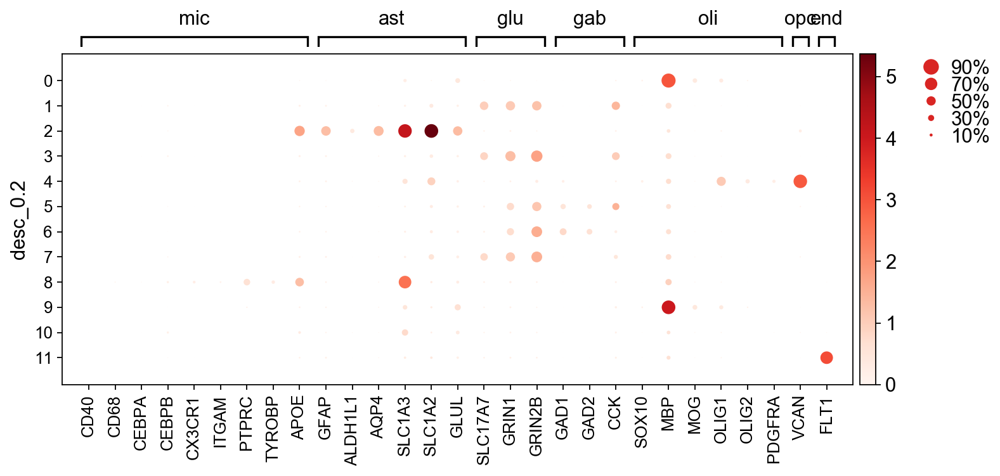

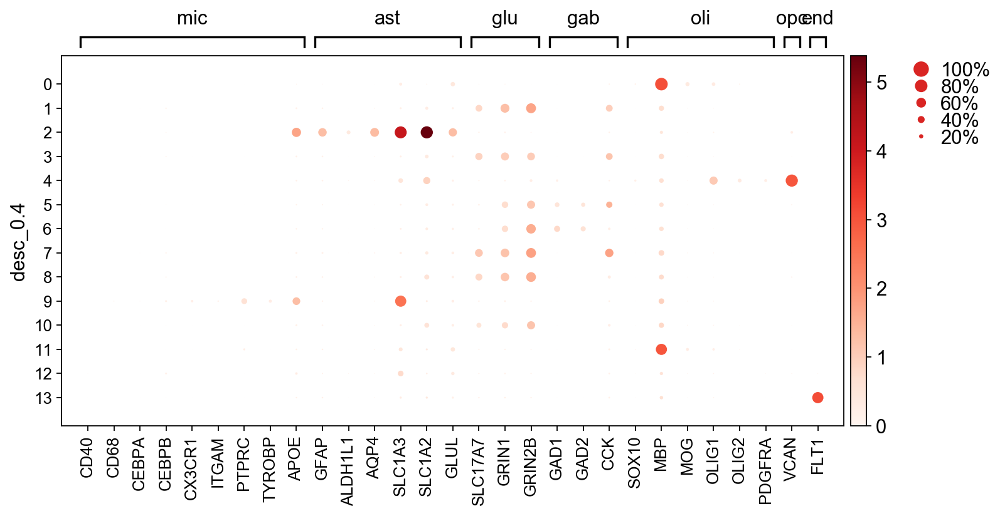

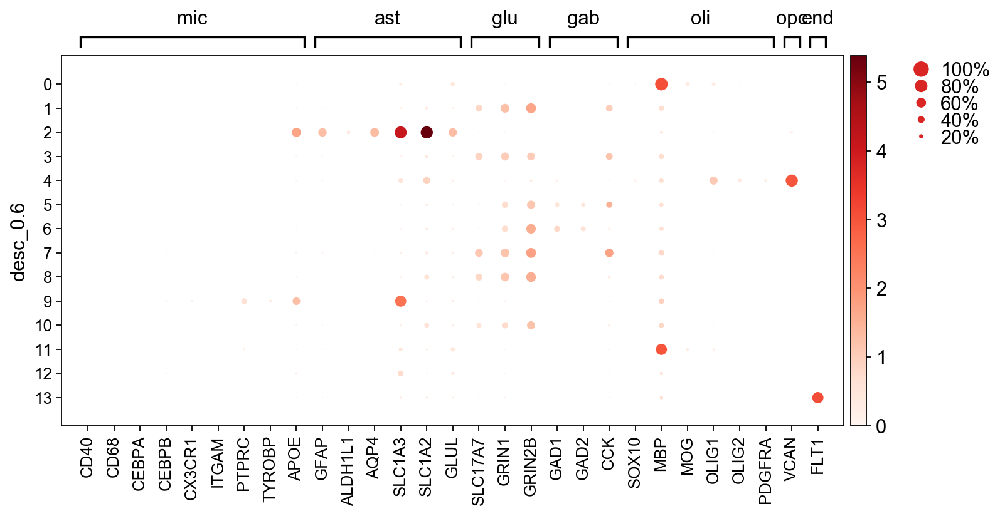

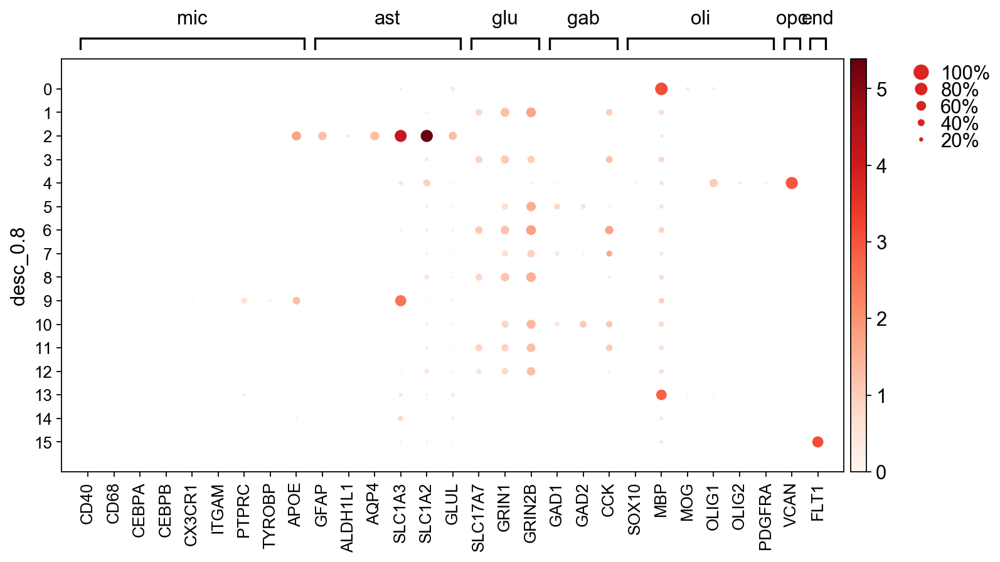

In [18]:
for ires in res:
    ax = sc.pl.dotplot(adata, mks, groupby='desc_'+ires,var_group_positions=[(0,8),(9,14),(15,17),(18,20),(21,26),(27,27),(28,28)],var_group_labels=['mic','ast','glu','gab','oli','opc','end'])

In [21]:
#annotation manually
res=['0.1','0.15','0.2','0.25','0.3','0.35','0.4','0.45','0.5','0.55','0.6','0.65','0.7','0.75','0.8']
celltype=[None]*15

celltype[0]=['oli','glu','ast','gab','oli','glu','mic','oli']#0.1
celltype[1]=['oli','glu','ast','opc','gab','gab','glu','mic','oli','end']
celltype[2]=['oli','glu','ast','glu','opc','gab','gab','glu','mic','oli','oli','end']
celltype[3]=['oli','glu','ast','glu','opc','gab','gab','glu','mic','oli','oli','end']#0.25
celltype[4]=['oli','ast','glu','glu','opc','gab','gab','glu','glu','mic','oli','oli','end']
celltype[5]=['oli','ast','glu','glu','opc','gab','gab','glu','glu','mic','glu','oli','oli','end']
celltype[6]=['oli','glu','ast','glu','opc','gab','gab','glu','glu','mic','glu','oli','oli','end']#0.4
celltype[7]=['oli','glu','ast','glu','opc','gab','gab','glu','glu','mic','glu','oli','oli','end']
celltype[8]=['oli','glu','ast','glu','opc','gab','gab','glu','glu','mic','glu','oli','oli','end']
celltype[9]=['oli','glu','ast','glu','opc','gab','gab','glu','glu','mic','glu','oli','oli','end']
celltype[10]=['oli','glu','ast','glu','opc','gab','gab','glu','glu','mic','glu','oli','oli','end']
celltype[11]=['oli','glu','ast','glu','opc','gab','gab','glu','glu','mic','glu','glu','oli','oli','end']#0.65
celltype[12]=['oli','glu','ast','glu','opc','gab','gab','glu','glu','mic','glu','glu','oli','oli','end']
celltype[13]=['oli','glu','ast','glu','opc','gab','gab','glu','glu','mic','glu','glu','oli','oli','end']
celltype[14]=['oli','glu','ast','glu','opc','gab','glu','gab','glu','mic','gab','glu','glu','oli','oli','end']
for i in range(0,len(res)):
   adata.obs['celltype_'+res[i]] =adata.obs['desc_'+res[i]]
   adata.obs['celltype_'+res[i]] .replace(range(0,len(celltype[i])), celltype[i], inplace = True)  

In [22]:
for i in range(0,len(res)-1):
   print("desc_"+res[i]+" vs desc_"+res[i+1])
   tab=confusion_matrix(adata.obs['desc_'+res[i]],adata.obs['desc_'+res[i+1]])
   tab=tab[np.sum(tab,axis=1)!=0,]
 #  display(pd.DataFrame(tab))
   display(pd.DataFrame(tab,index=celltype[i],columns=celltype[i+1]))

desc_0.1 vs desc_0.15


,oli,glu,ast,opc,gab,gab,glu,mic,oli,end
oli,37452,16,11,88,54,46,54,79,651,3
glu,12,23891,7,3,89,25,880,8,11,0
ast,9,12,16219,14,25,42,4,2,20,0
gab,4,5,1,2,6465,6280,85,1,5,0
oli,536,5,3,8720,11,10,8,7,107,1
glu,11,177,12,2,108,126,14350,5,8,0
mic,764,18,9,10,24,19,12,5754,113,2
oli,1689,7,9,46,12,18,9,99,5385,458


desc_0.15 vs desc_0.2


,oli,glu,ast,glu,opc,gab,gab,glu,mic,oli,oli,end
oli,38712,29,6,320,7,12,12,16,4,1359,0,0
glu,16,16498,4,7501,7,7,3,65,12,16,2,0
ast,26,27,15956,93,5,17,11,35,23,77,1,0
opc,1556,13,14,49,6978,11,12,10,10,229,2,1
gab,16,27,0,276,1,6409,4,18,2,35,0,0
gab,17,3,1,304,0,24,6187,14,4,10,1,1
glu,18,271,3,9743,3,10,14,5313,10,17,0,0
mic,700,13,4,40,0,3,3,6,4080,1105,0,1
oli,4382,18,26,47,10,9,13,11,18,1109,651,6
end,7,1,0,3,0,0,0,0,0,0,0,453


desc_0.2 vs desc_0.25


,oli,glu,ast,glu,opc,gab,gab,glu,mic,oli,oli,end
oli,45286,1,1,9,1,1,0,0,0,151,0,0
glu,0,16887,0,7,0,0,0,2,0,4,0,0
ast,2,0,16004,1,0,0,0,1,1,5,0,0
glu,1,32,1,18332,0,0,1,4,0,5,0,0
opc,2,0,0,0,7007,0,0,0,0,2,0,0
gab,0,0,1,0,0,6497,1,1,0,2,0,0
gab,0,0,0,0,0,0,6257,1,0,1,0,0
glu,0,4,1,10,0,0,0,5472,0,1,0,0
mic,2,1,1,0,0,0,0,0,4159,0,0,0
oli,24,1,1,0,0,0,0,1,1,3929,0,0


desc_0.25 vs desc_0.3


,oli,ast,glu,glu,opc,gab,gab,glu,glu,mic,oli,oli,end
oli,44466,1,32,75,0,4,5,46,5,2,681,0,0
glu,4,2,12641,15,3,3,1,4234,15,1,7,0,0
ast,20,15867,41,11,2,10,3,39,6,1,10,0,0
glu,26,2,276,15451,2,1,1,2576,3,0,21,0,0
opc,25,1,3,3,6928,1,0,8,2,0,37,0,0
gab,3,2,6,7,0,6415,4,49,6,0,5,1,0
gab,9,0,7,8,1,7,6197,18,5,0,7,0,0
glu,1,0,40,20,1,0,1,740,4670,0,9,0,0
mic,10,3,6,6,1,1,1,11,8,4109,5,0,0
oli,776,6,18,14,1,10,2,32,8,3,3228,1,1


desc_0.3 vs desc_0.35


,oli,ast,glu,glu,opc,gab,gab,glu,glu,mic,glu,oli,oli,end
oli,44932,4,65,28,2,0,3,15,7,5,5,273,0,2
ast,11,15845,3,3,1,2,0,10,0,3,1,5,0,0
glu,4,2,4,12932,0,2,2,119,0,0,4,1,0,0
glu,15,4,15437,19,0,0,4,122,5,2,1,4,0,0
opc,10,0,5,9,6904,0,1,6,0,0,0,4,0,0
gab,0,0,4,0,2,6425,7,4,0,1,1,8,0,0
gab,4,1,1,1,2,5,6189,3,1,1,6,1,0,0
glu,6,2,452,252,0,8,6,6974,28,0,8,17,0,0
glu,3,3,3,5,2,5,2,13,3633,6,1052,1,0,0
mic,3,1,3,3,0,1,3,6,0,4095,0,1,0,0


desc_0.35 vs desc_0.4


,oli,glu,ast,glu,opc,gab,gab,glu,glu,mic,glu,oli,oli,end
oli,45480,201,7,16,6,12,7,43,2,11,15,150,2,0
ast,24,4,15835,3,2,2,1,4,0,1,0,2,0,0
glu,15,15404,4,153,2,12,5,411,2,1,1,1,0,1
glu,13,24,1,13171,3,0,0,55,4,2,4,2,0,0
opc,3,4,0,1,6903,1,0,0,0,0,1,1,0,0
gab,5,2,2,2,1,6439,6,8,1,2,0,1,0,1
gab,9,2,0,1,0,7,6206,1,0,1,1,2,0,0
glu,4,680,5,208,1,5,1,6403,14,0,1,0,0,0
glu,1,21,0,0,0,1,0,13,3638,0,6,1,0,0
mic,15,1,0,2,0,1,5,9,0,4103,0,1,0,0


desc_0.4 vs desc_0.45


,oli,glu,ast,glu,opc,gab,gab,glu,glu,mic,glu,oli,oli,end
oli,46423,5,0,2,0,0,0,0,0,0,0,5,1,0
glu,0,16374,0,2,1,0,0,13,0,0,0,0,0,0
ast,0,0,15862,0,0,0,0,0,0,0,0,0,0,0
glu,0,1,0,13555,0,0,0,9,0,1,1,0,0,0
opc,0,0,0,0,6925,0,0,0,0,0,0,0,0,0
gab,0,0,1,0,0,6517,0,0,0,0,0,0,0,0
gab,0,0,0,0,0,0,6240,0,0,0,0,0,0,0
glu,1,13,0,9,0,0,1,6970,2,0,0,1,0,0
glu,0,0,0,0,0,0,0,1,3671,0,0,0,0,0
mic,0,0,0,1,0,0,0,0,0,4144,0,0,0,0


desc_0.45 vs desc_0.5


,oli,glu,ast,glu,opc,gab,gab,glu,glu,mic,glu,oli,oli,end
oli,46422,1,0,0,0,0,1,0,0,0,1,1,0,0
glu,0,16389,0,0,0,0,0,5,0,0,0,0,0,0
ast,0,0,15863,0,0,0,0,0,0,0,0,0,0,0
glu,1,2,0,13564,0,0,0,1,0,1,0,0,0,0
opc,0,0,0,0,6926,0,0,0,0,0,0,0,0,0
gab,0,1,0,0,0,6517,0,0,0,0,0,0,0,0
gab,0,0,0,0,0,0,6240,0,0,0,0,1,0,0
glu,0,2,0,2,0,0,0,6990,1,0,0,0,0,0
glu,0,0,0,0,0,0,0,0,3673,0,0,0,0,0
mic,0,0,0,1,0,0,0,0,0,4146,0,0,0,0


desc_0.5 vs desc_0.55


,oli,glu,ast,glu,opc,gab,gab,glu,glu,mic,glu,oli,oli,end
oli,46413,3,0,3,0,0,0,0,0,1,1,7,0,0
glu,5,16373,0,2,0,0,0,16,0,0,1,0,0,0
ast,0,0,15862,0,0,1,0,0,0,0,0,0,0,0
glu,1,2,0,13551,0,0,0,12,0,0,0,1,0,0
opc,0,0,0,0,6926,0,0,0,0,0,0,0,0,0
gab,0,0,0,0,0,6516,0,0,0,0,0,1,0,0
gab,0,0,0,0,0,1,6239,1,0,0,0,0,0,0
glu,0,4,0,15,0,0,0,6977,0,0,0,0,0,0
glu,0,0,0,0,0,0,0,0,3674,0,0,0,0,0
mic,0,0,0,0,0,0,0,0,0,4146,0,2,0,0


desc_0.55 vs desc_0.6


,oli,glu,ast,glu,opc,gab,gab,glu,glu,mic,glu,oli,oli,end
oli,46388,3,0,0,0,0,0,0,0,1,0,30,0,0
glu,3,16368,0,1,0,1,0,5,0,0,0,4,0,0
ast,0,0,15859,0,0,0,0,0,0,0,0,3,0,0
glu,2,1,0,13558,0,0,0,10,0,0,1,0,1,0
opc,0,0,0,0,6926,0,0,0,0,0,0,1,0,0
gab,0,0,1,0,0,6516,1,0,0,0,0,0,0,0
gab,0,0,0,0,0,0,6239,0,0,0,0,1,0,0
glu,0,13,1,10,0,0,1,6976,0,0,2,7,0,0
glu,0,0,0,0,0,0,0,1,3673,0,0,0,0,0
mic,0,0,0,2,0,0,0,0,0,4143,0,2,0,0


desc_0.6 vs desc_0.65


,oli,glu,ast,glu,opc,gab,gab,glu,glu,mic,glu,glu,oli,oli,end
oli,45842,72,5,52,2,3,3,32,0,6,11,1,366,0,0
glu,32,15074,2,19,2,2,2,591,5,0,630,0,26,1,0
ast,12,3,15777,12,2,4,6,22,2,2,15,0,4,0,0
glu,4,2,0,10019,2,0,1,3,2,1,3534,1,2,0,0
opc,11,4,4,3,6893,2,0,1,0,0,3,0,5,0,0
gab,3,8,0,10,0,6455,1,12,1,0,8,0,19,0,0
gab,9,2,0,6,0,24,6174,14,3,1,5,0,3,0,0
glu,7,81,3,46,0,1,2,5752,34,7,1052,0,7,0,0
glu,2,1,0,9,0,0,1,16,3630,0,4,8,2,0,0
mic,8,5,2,6,2,1,1,6,0,4089,4,0,20,0,0


desc_0.65 vs desc_0.7


,oli,glu,ast,glu,opc,gab,gab,glu,glu,mic,glu,glu,oli,oli,end
oli,46044,4,0,1,0,0,0,0,0,0,0,0,9,0,0
glu,0,15259,0,0,0,0,0,3,0,0,1,0,0,0,0
ast,0,0,15796,0,0,0,0,0,0,0,0,0,1,0,0
glu,0,0,0,10193,0,0,0,0,0,0,4,0,1,0,0
opc,0,0,0,0,6904,0,0,0,0,0,0,0,0,0,0
gab,0,0,0,0,0,6498,0,0,0,0,0,0,0,0,0
gab,0,0,0,0,0,0,6198,1,0,0,0,0,0,0,0
glu,1,3,0,1,0,0,0,6480,1,0,5,0,1,0,0
glu,0,0,0,0,0,0,0,0,3698,0,0,0,0,0,0
mic,0,0,0,0,0,0,0,0,0,4107,0,0,1,0,0


desc_0.7 vs desc_0.75


,oli,glu,ast,glu,opc,gab,gab,glu,glu,mic,glu,glu,oli,oli,end
oli,46043,0,0,1,0,0,0,0,1,0,1,0,3,0,0
glu,1,15255,0,0,0,0,0,11,0,0,0,0,0,0,0
ast,0,0,15796,0,0,0,0,0,0,0,0,0,0,0,0
glu,1,0,0,10189,0,0,0,1,0,0,6,0,0,0,0
opc,0,0,0,0,6904,0,0,0,0,0,0,0,0,0,0
gab,0,0,0,0,0,6498,0,0,0,0,0,0,0,0,0
gab,0,0,0,0,0,0,6198,0,0,0,0,0,0,0,0
glu,0,1,0,0,0,0,0,6483,0,0,1,0,0,0,0
glu,0,0,0,0,0,0,0,0,3699,0,0,0,0,0,0
mic,0,0,0,0,0,0,0,0,0,4107,0,0,0,0,0


desc_0.75 vs desc_0.8


,oli,glu,ast,glu,opc,gab,glu,gab,glu,mic,gab,glu,glu,oli,oli,end
oli,45929,52,11,11,2,20,11,5,1,4,4,3,1,2,1,0
glu,28,15158,3,0,5,3,49,3,1,0,2,8,0,0,1,0
ast,3,0,15755,2,4,2,8,8,0,1,12,0,0,2,0,0
glu,11,2,4,10047,0,5,3,3,1,1,5,112,1,1,0,0
opc,2,0,0,1,6891,1,0,3,0,0,5,1,0,0,0,0
gab,3,6,2,1,1,13,13,4169,0,1,2286,4,1,0,1,0
gab,1,0,0,1,0,6120,7,2,0,0,66,0,0,1,0,0
glu,11,134,6,2,0,15,6267,19,5,1,6,39,0,0,0,1
glu,4,2,1,1,1,4,18,4,3658,0,2,1,4,0,0,0
mic,5,0,2,1,0,5,3,7,1,4076,7,0,0,1,0,0


In [23]:
celltype_idx=['glu','oli','gab','ast','mic','opc','end']
cells=adata.obs.keys()[(adata.obs.keys().str.startswith('celltype'))]
nn=len(res)
adata.obs['final_celltype']='none'
celltype=celltype_idx
for i in range(0,len(celltype)):
    if (celltype[i]!='opc')&(celltype[i]!='end'):
        adata.obs['final_celltype'][np.sum(adata.obs[cells]==celltype[i],axis=1)==nn]=celltype[i]
    else:
        adata.obs['final_celltype'][np.sum(adata.obs[cells]==celltype[i],axis=1)==nn-1]=celltype[i]
display(adata.obs['final_celltype'].value_counts())

C:\Users\wangk\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.
C:\Users\wangk\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


oli     44182
glu     39176
ast     15683
gab     12286
none     8633
opc      6853
mic      3982
end       444
Name: final_celltype, dtype: int64

In [24]:
tab=pd.DataFrame(adata.obs['final_celltype'].value_counts())
tab.final_celltype.sum(axis=0)-tab.loc['none']

final_celltype    122606
Name: none, dtype: int64

0.2


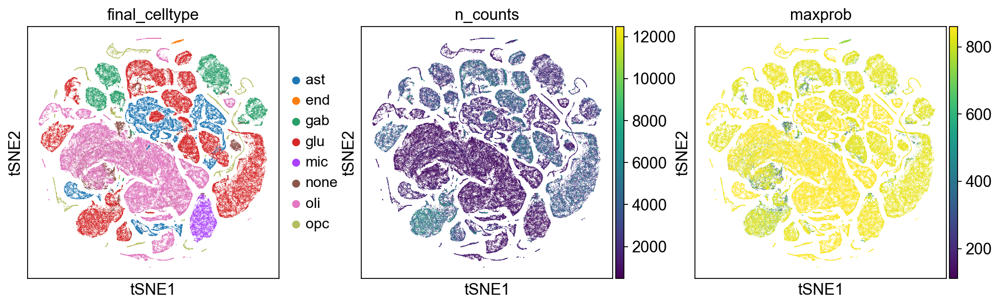

0.4


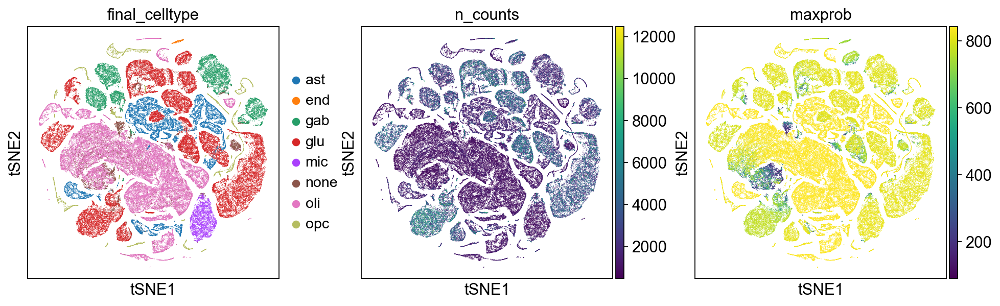

0.6


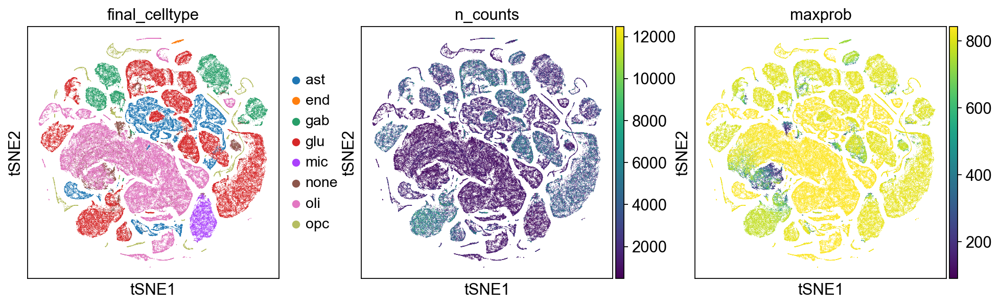

0.8


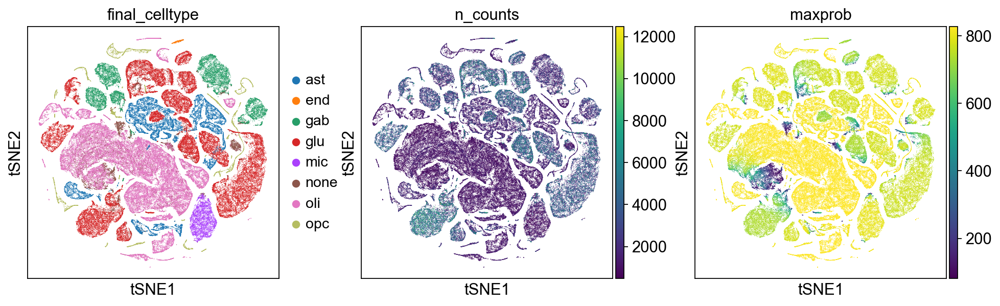

In [41]:
for ires in [0.2,0.4,0.6,0.8]:
    print(ires)
    adata.obs['maxprob']=(np.max(adata.uns['prob_matrix'+str(ires)],axis=1)*1000).astype(int)
    adata.obsm.X_tsne=adata.obsm['X_tsne'+str(ires)]
    sc.pl.tsne(adata, color=['final_celltype','n_counts','maxprob'])

In [38]:
for i in range(0,len(res)-1):
    print("celltype_"+res[i]+" vs celltype_"+res[i+1])
    tab=confusion_matrix(adata.obs['celltype_'+res[i]],adata.obs['celltype_'+res[i+1]],labels=celltype_idx)
    display(pd.DataFrame(tab,index=celltype_idx,columns=celltype_idx))

celltype_0.1 vs celltype_0.15


,glu,oli,gab,ast,mic,opc,end
glu,39298,42,348,19,13,5,0
oli,99,45820,151,23,185,8854,462
gab,90,9,12745,1,1,2,0
ast,16,29,67,16219,2,14,0
mic,30,877,43,9,5754,10,2
opc,0,0,0,0,0,0,0
end,0,0,0,0,0,0,0


celltype_0.15 vs celltype_0.2


,glu,oli,gab,ast,mic,opc,end
glu,39391,69,34,7,22,10,0
oli,441,46213,46,32,22,17,6
gab,642,79,12624,1,6,1,1
ast,155,104,28,15956,23,5,0
mic,59,1805,6,4,4080,0,1
opc,72,1787,23,14,10,6978,1
end,4,7,0,0,0,0,453


celltype_0.2 vs celltype_0.25


,glu,oli,gab,ast,mic,opc,end
glu,40750,11,1,2,0,0,0
oli,12,50047,1,2,1,1,0
gab,2,3,12755,1,0,0,0
ast,2,7,0,16004,1,0,0
mic,1,2,0,1,4159,0,0
opc,0,4,0,0,0,7007,0
end,0,0,0,0,0,0,462


celltype_0.25 vs celltype_0.3


,glu,oli,gab,ast,mic,opc,end
glu,40681,68,7,4,1,6,0
oli,231,49808,21,7,5,1,1
gab,106,25,12623,2,0,1,0
ast,97,30,13,15867,1,2,0
mic,31,15,2,3,4109,1,0
opc,16,62,1,1,0,6928,0
end,2,2,0,0,0,0,458


celltype_0.3 vs celltype_0.35


,glu,oli,gab,ast,mic,opc,end
glu,41063,51,29,11,8,2,0
oli,252,49667,37,20,29,3,2
gab,21,13,12626,1,2,4,0
ast,17,16,2,15845,3,1,0
mic,12,4,4,1,4095,0,0
opc,20,14,1,0,0,6904,0
end,1,0,1,0,0,0,457


celltype_0.35 vs celltype_0.4


,glu,oli,gab,ast,mic,opc,end
glu,41303,38,25,10,3,6,1
oli,429,49207,65,15,35,13,1
gab,18,17,12658,2,3,1,1
ast,11,26,3,15835,1,2,0
mic,12,16,6,0,4103,0,0
opc,6,4,1,0,0,6903,0
end,0,3,0,0,0,0,456


celltype_0.4 vs celltype_0.45


,glu,oli,gab,ast,mic,opc,end
glu,41773,3,1,0,1,1,0
oli,10,49298,1,0,2,0,0
gab,0,0,12757,1,0,0,0
ast,0,0,0,15862,0,0,0
mic,1,0,0,0,4144,0,0
opc,0,0,0,0,0,6925,0
end,0,0,0,0,0,0,459


celltype_0.45 vs celltype_0.5


,glu,oli,gab,ast,mic,opc,end
glu,41781,2,0,0,1,0,0
oli,4,49295,1,0,1,0,0
gab,1,1,12757,0,0,0,0
ast,0,0,0,15863,0,0,0
mic,1,0,0,0,4146,0,0
opc,0,0,0,0,0,6926,0
end,0,0,0,0,0,0,459


celltype_0.5 vs celltype_0.55


,glu,oli,gab,ast,mic,opc,end
glu,41780,7,0,0,0,0,0
oli,10,49285,1,0,1,1,0
gab,1,1,12756,0,0,0,0
ast,0,0,1,15862,0,0,0
mic,0,2,0,0,4146,0,0
opc,0,0,0,0,0,6926,0
end,0,0,0,0,0,0,459


celltype_0.55 vs celltype_0.6


,glu,oli,gab,ast,mic,opc,end
glu,41766,22,2,1,0,0,0
oli,3,49291,0,0,1,0,0
gab,0,1,12756,1,0,0,0
ast,0,3,0,15859,0,0,0
mic,2,2,0,0,4143,0,0
opc,0,1,0,0,0,6926,0
end,0,0,0,0,0,0,459


celltype_0.6 vs celltype_0.65


,glu,oli,gab,ast,mic,opc,end
glu,41618,119,16,5,8,5,0
oli,226,49063,12,9,8,2,0
gab,69,34,12654,0,1,0,0
ast,54,16,10,15777,2,2,0
mic,21,28,2,2,4089,2,0
opc,11,16,2,4,0,6893,0
end,1,0,1,0,0,0,457


celltype_0.65 vs celltype_0.7


,glu,oli,gab,ast,mic,opc,end
glu,41996,4,0,0,0,0,0
oli,5,49271,0,0,0,0,0
gab,1,0,12696,0,0,0,0
ast,0,1,0,15796,0,0,0
mic,0,1,0,0,4107,0,0
opc,0,0,0,0,0,6904,0
end,0,0,0,0,0,0,457


celltype_0.7 vs celltype_0.75


,glu,oli,gab,ast,mic,opc,end
glu,42000,2,0,0,0,0,0
oli,7,49265,3,1,1,0,0
gab,0,0,12696,0,0,0,0
ast,0,0,0,15796,0,0,0
mic,0,0,0,0,4107,0,0
opc,0,0,0,0,0,6904,0
end,0,0,0,0,0,0,457


celltype_0.75 vs celltype_0.8


,glu,oli,gab,ast,mic,opc,end
glu,41835,58,85,20,2,6,1
oli,296,48796,112,31,28,3,1
gab,33,6,12656,2,1,1,0
ast,10,5,22,15755,1,4,0
mic,5,6,19,2,4076,0,0
opc,2,2,9,0,0,6891,0
end,0,0,3,0,0,0,454


In [61]:
adata.write("brain.h5ad")

In [53]:
from matplotlib.cm import get_cmap
import matplotlib as mpl
cmap_tab10 = get_cmap('tab10')
cmap = mpl.colors.ListedColormap([cmap_tab10.colors[0],cmap_tab10.colors[3],cmap_tab10.colors[2],cmap_tab10.colors[4],cmap_tab10.colors[1],cmap_tab10.colors[8],cmap_tab10.colors[9]])

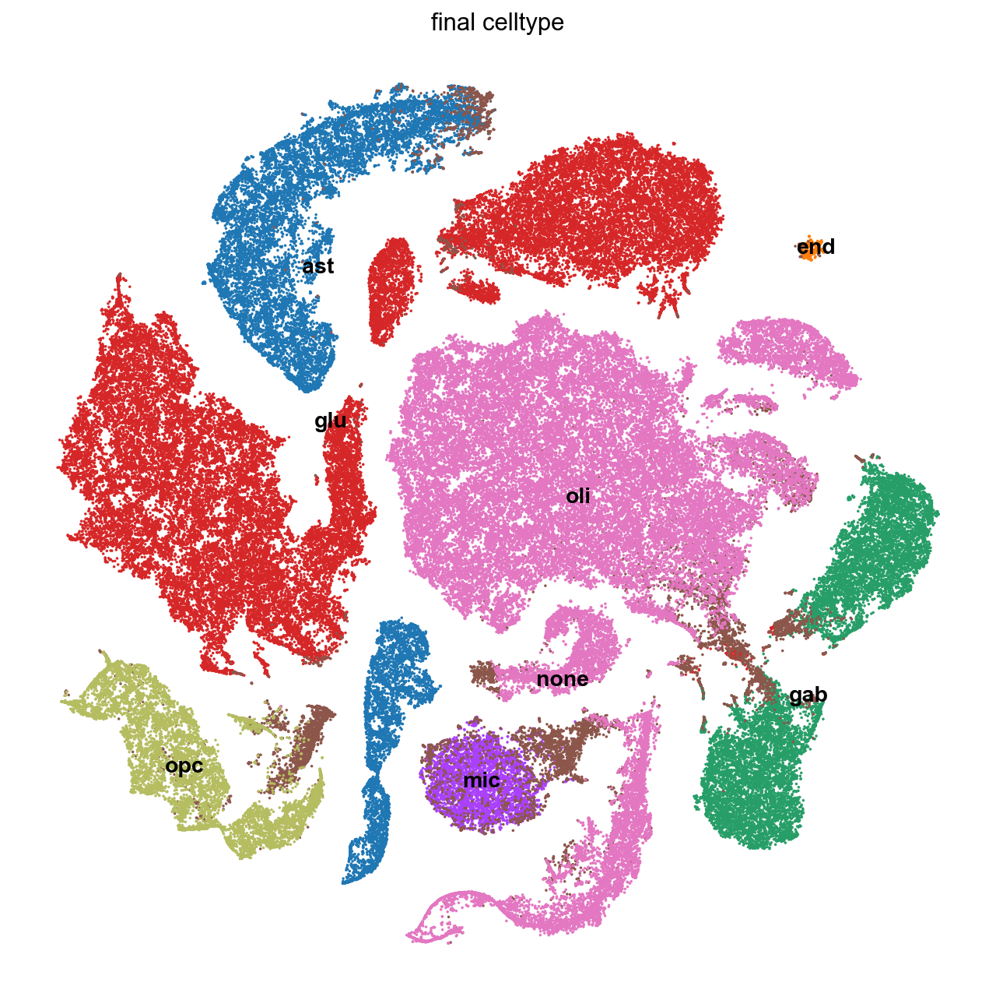

In [60]:
ires='0.15'
adata.obsm['X_tsne']=adata.obsm['X_tsne'+ires+'_600_120']
ncols=1
nrows=1
fig, axes = plt.subplots(ncols=ncols, nrows=nrows, figsize=[ncols*10,nrows*10])
ax=sc.pl.scatter(adata,basis='tsne',
                 color='final_celltype',
                 legend_loc='on data',
                 ax=axes,
                 size=10,
                 color_map=cmap,
                 show=False)
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)